# Sector 6 EDA

This notebook will look at the regions of $\alpha > 1.05$ of the `eleanor` lightcurves.

In [1]:
cd ..

/home/astro/phrdhx/automated_exocomet_hunt


In [2]:
from analysis_tools_cython import *
from post_processing_tools import *
from matplotlib.patches import Rectangle

In [3]:
df = get_output('output_log_xrp/output_s6.txt')
filtered_df = filter_df(df)

In [4]:
filtered_df

,file,signal,signal/noise,time,asym_score,width1,width2,duration,depth,transit_prob
3,tesslc_709917564.pkl,-8.167271,-3.018526,1475.807548,1.004976,0.124157,0.030575,1.083337,-0.000134,maybeTransit
6,tesslc_281413400.pkl,-3.572121,-2.017223,1475.203690,0.994209,0.294992,0.157249,0.833339,-0.000882,maybeTransit
30,tesslc_306771787.pkl,-4.415027,-3.914689,1481.718922,1.010016,0.135463,0.592901,1.333359,-0.001213,maybeTransit
32,tesslc_41232201.pkl,-4.914540,-3.578164,1474.240195,0.907402,0.007174,1.988791,0.666667,-0.001776,maybeTransit
36,tesslc_47544487.pkl,-5.655765,-4.628218,1475.848189,0.991649,0.409749,0.202807,1.020838,-0.003164,maybeTransit
...,...,...,...,...,...,...,...,...,...,...
2779713,tesslc_408902565.pkl,-7.991520,-4.130372,1472.140623,1.017152,0.253400,0.003613,0.562497,-0.000941,maybeTransit
2779714,tesslc_96587017.pkl,-7.849947,-3.137998,1487.785209,1.015703,0.307785,0.071227,0.604176,-0.000550,maybeTransit
2779716,tesslc_39842254.pkl,-6.747414,-4.087477,1484.557750,0.999547,0.367485,0.023886,0.604161,-0.000236,maybeTransit
2779720,tesslc_220211279.pkl,-5.582913,-3.635905,1481.974913,1.012671,0.327078,0.045583,0.541670,-0.000063,maybeTransit


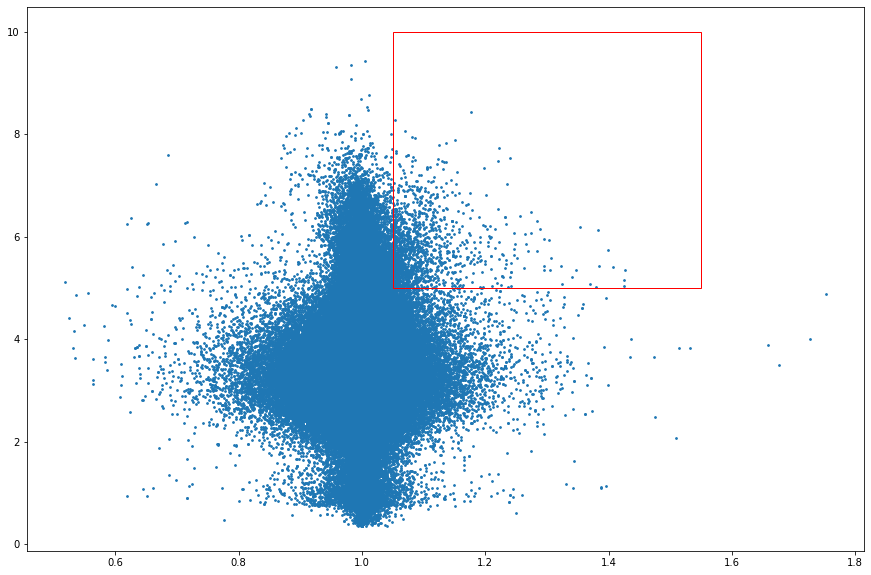

In [5]:
# Create figure and axes
fig, ax = plt.subplots(figsize=(15,10))

# Display the image
ax.scatter(filtered_df['asym_score'],abs(filtered_df['signal/noise']),s=3)

# Create a Rectangle patch
rect = Rectangle((1.05, 5), 0.5,5, linewidth=1, edgecolor='r', facecolor='none')

# Add the patch to the Axes
ax.add_patch(rect)

## Region of interest

In [6]:
new_df = filtered_df[(filtered_df["asym_score"] >= 1.0) & (filtered_df["asym_score"] <= 2.0)]
new_df = new_df[new_df['signal/noise'] <= -5]

(0.0, 10.0)

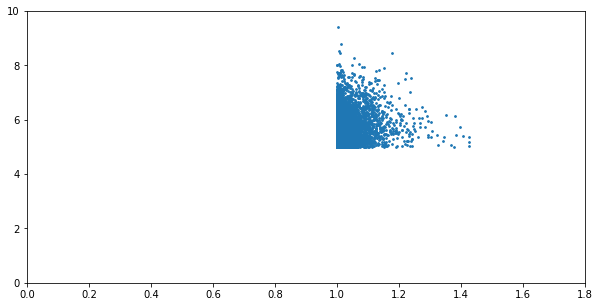

In [7]:
plt.figure(figsize=(10,5))
plt.scatter(new_df.asym_score,abs(new_df['signal/noise']),s=3)
plt.xlim([0,1.8])
plt.ylim([0,10])

---

## Get lightcurves

In [8]:
test_df = new_df.reset_index()

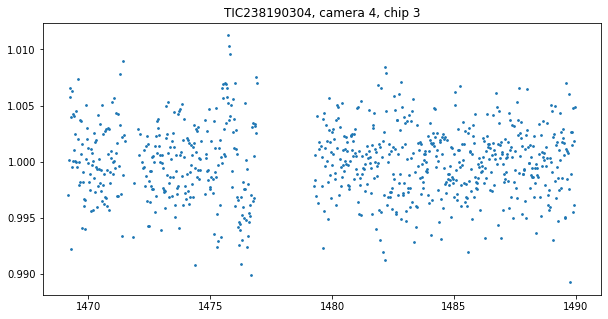

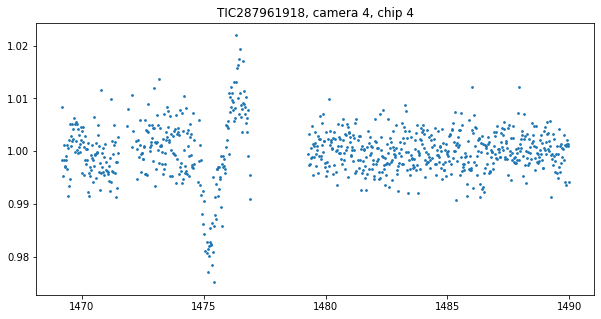

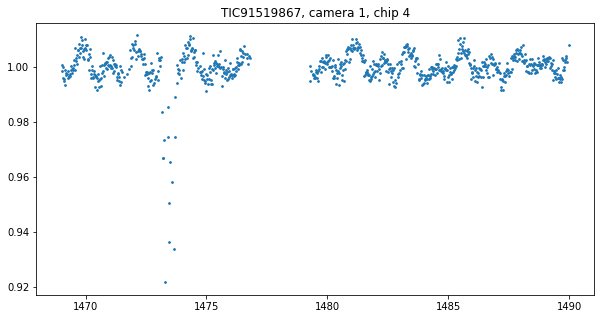

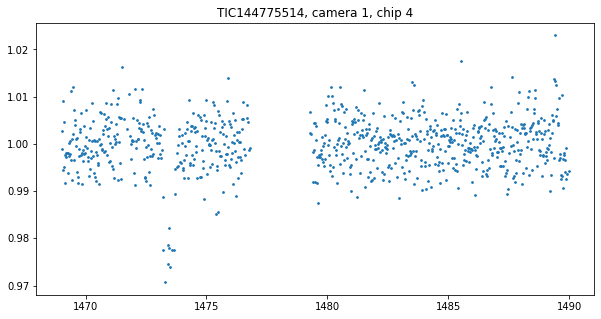

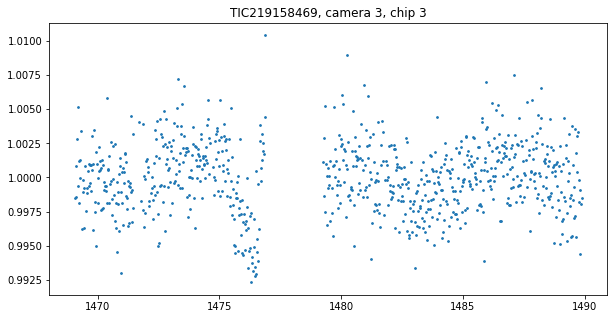

...

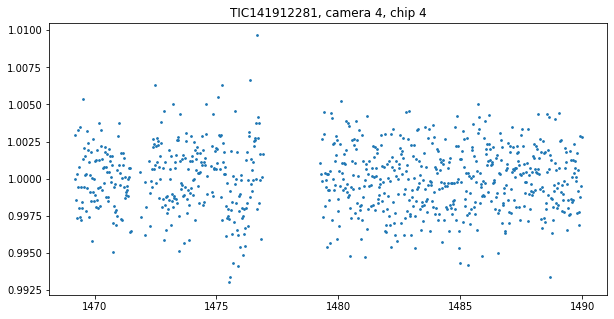

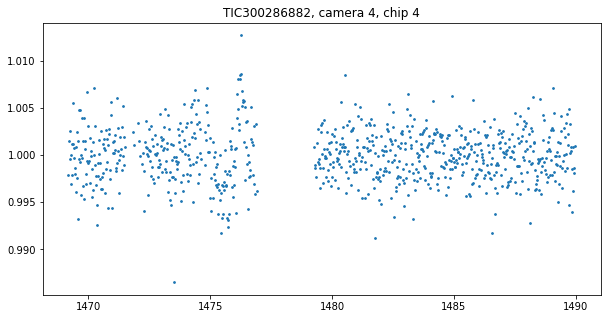

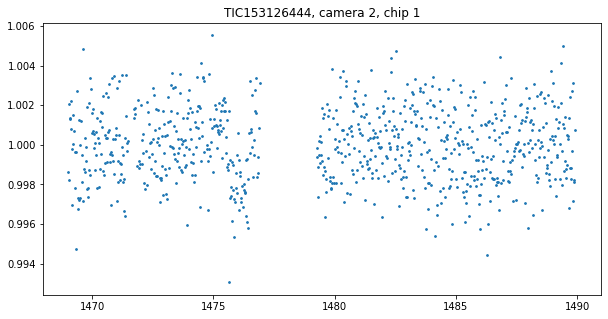

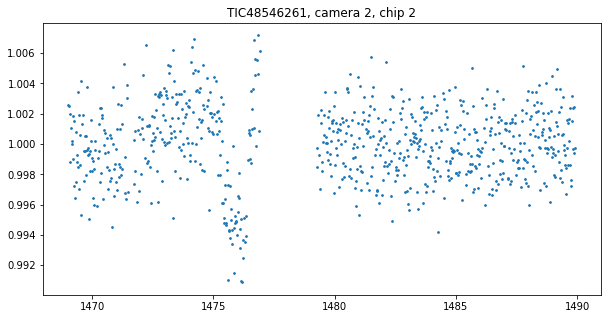

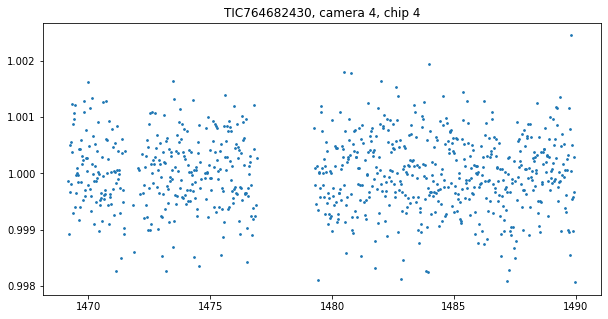

In [9]:
sector = 6
for i in test_df.file.head(50):
        file_paths = glob.glob(os.path.join(f'/storage/astro2/phrdhx/tesslcs/tesslcs_sector_{sector}_104/', f"**/{i}"))[0]

        try:
            table, info = import_XRPlightcurve(file_paths, sector=sector, clip=3, drop_bad_points=True)
            tic = info[0]
            camera = info[4]
            chip = info[5]
        except: # FileNotFoundError
            print(f"file {file_paths} does not exist")
        fig,ax = plt.subplots(1,figsize=(10,5))
        ax.scatter(table['time'],normalise_lc(table['corrected flux']),s=3)
        ax.title.set_text(f"TIC{tic}, camera {camera}, chip {chip}")

## Retrieve lightcurve TIC ID's from Camera 1 Chip 4

Total 1201 lightcurves with this SCD combination.

In [10]:
import tqdm

100%|██████████| 7896/7896 [18:42<00:00,  7.03it/s]


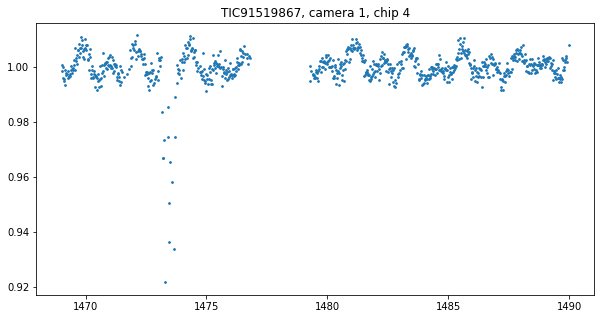

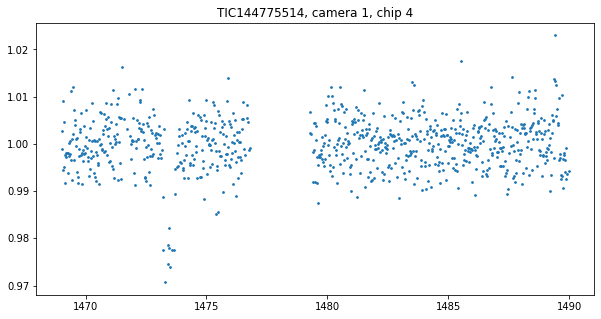

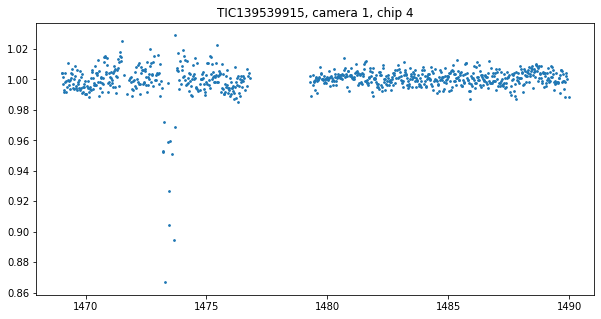

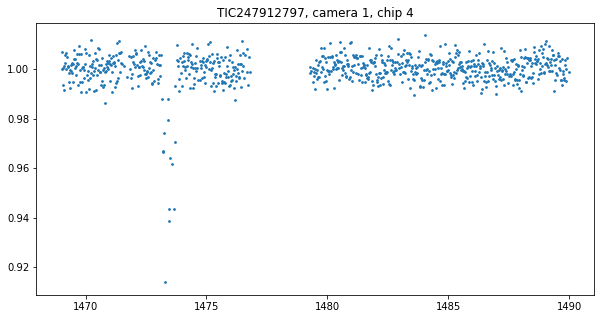

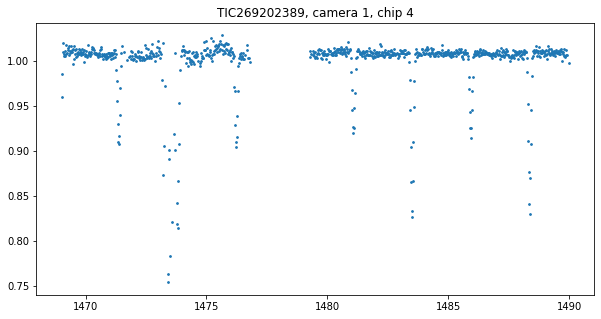

...

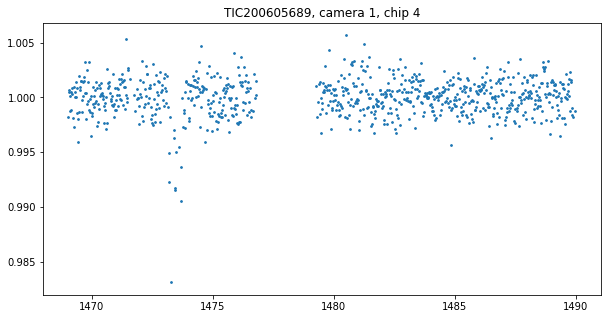

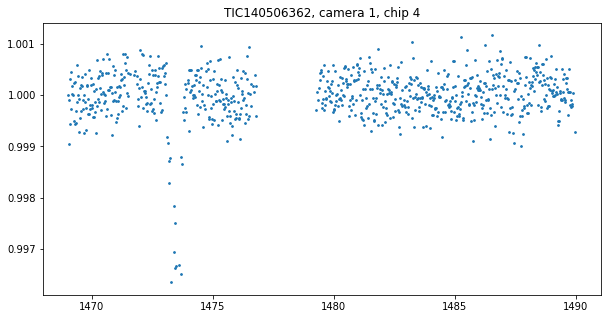

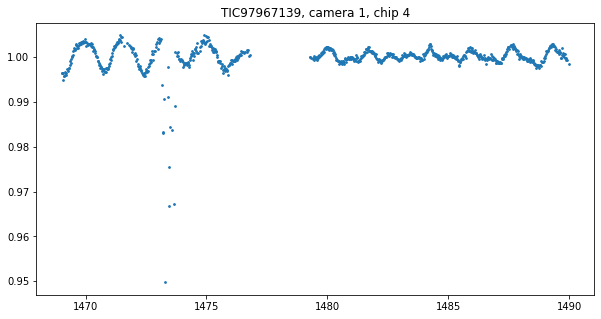

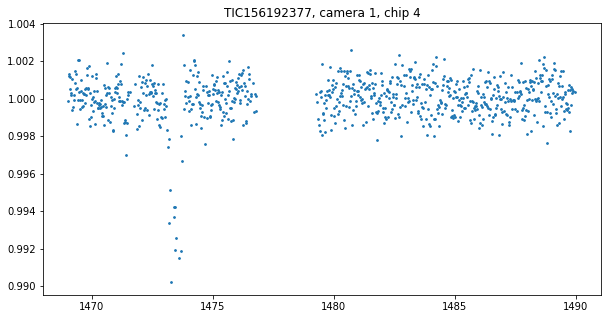

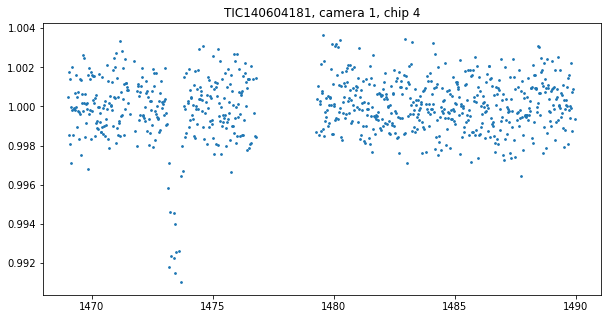

In [11]:
sector = 6
list_tic_faulty = []
file_path_faulty = []
for i in tqdm.tqdm(test_df.file):
        file_paths = glob.glob(os.path.join(f'/storage/astro2/phrdhx/tesslcs/tesslcs_sector_{sector}_104/', f"**/{i}"))[0]

        try:
            table, info = import_XRPlightcurve(file_paths, sector=sector, clip=3, drop_bad_points=True)
            tic = info[0]
            camera = info[4]
            chip = info[5]
        except: # FileNotFoundError
            print(f"file {file_paths} does not exist")
        if (camera == 1) & (chip == 4):
            list_tic_faulty.append(tic)
            file_path_faulty.append(file_paths)
            fig,ax = plt.subplots(1,figsize=(10,5))
            ax.scatter(table['time'],normalise_lc(table['corrected flux']),s=3)
            ax.title.set_text(f"TIC{tic}, camera {camera}, chip {chip}")

In [12]:
len(list_tic_faulty)

1201

#### Going to do a manual import of these lightcurves (no functions from `analysis_tools_cython` used to see if it's method or lightcurves that are faulty)

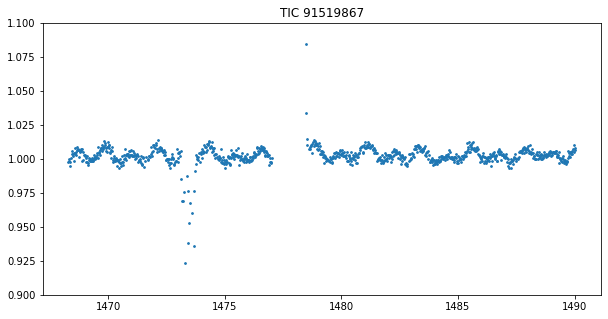

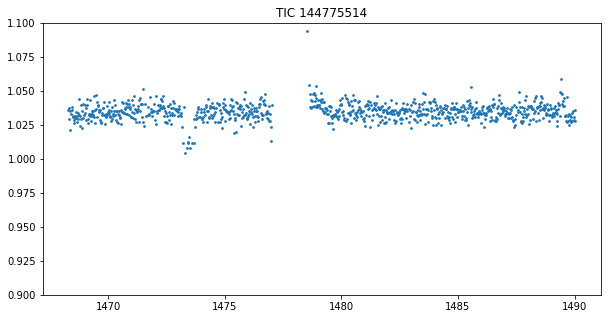

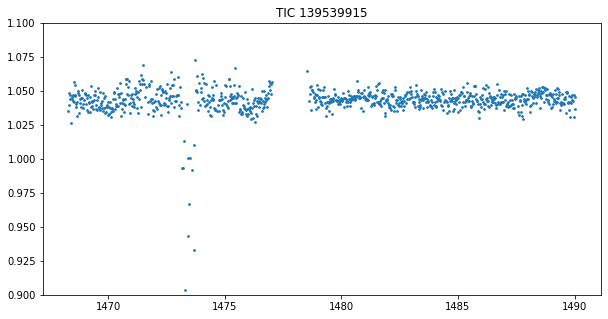

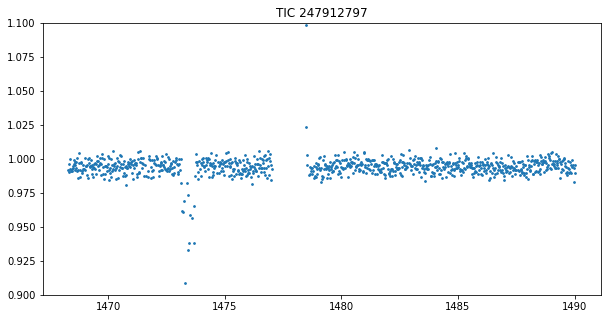

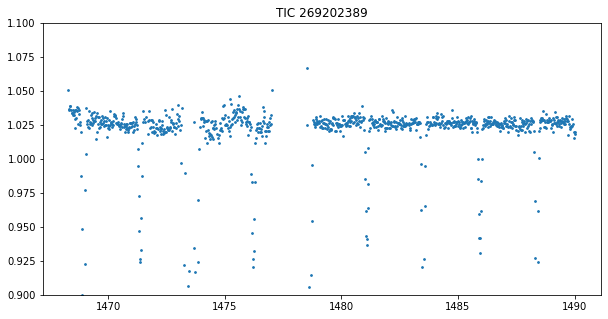

...

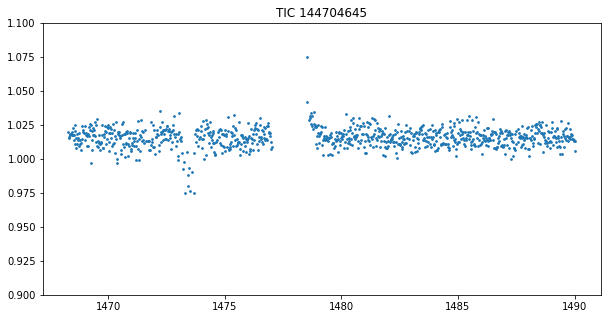

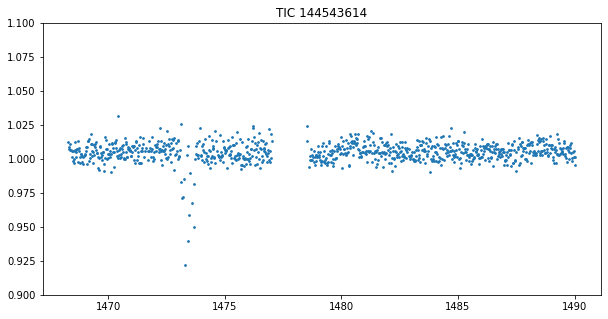

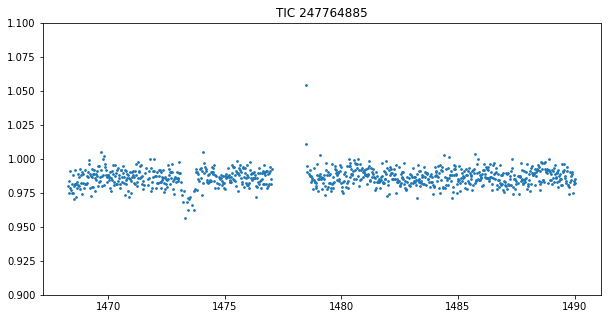

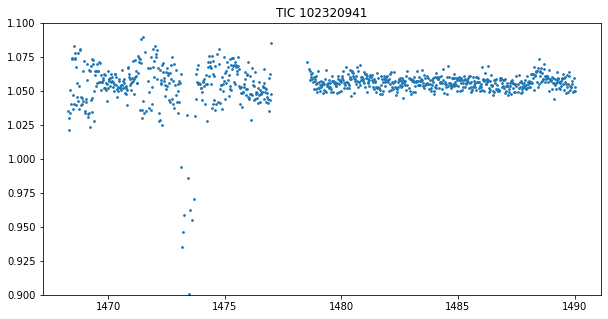

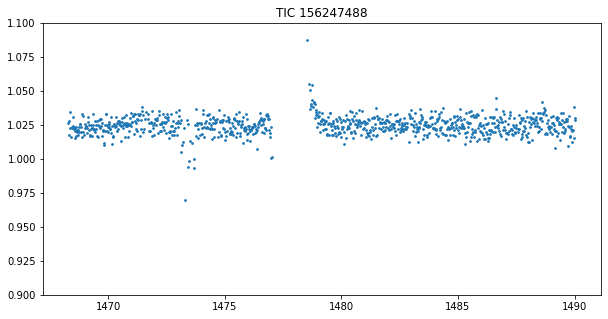

In [13]:
for i in file_path_faulty[0:50]:
    lc = pd.read_pickle(i)
    tic = lc[0]
    time = lc[6]
    corr_flux = lc[8] # 8 == corr, 9 == PCA (used for verifying if chip fault is only in corr or not)
    q = lc[11] == 0
    fig,ax = plt.subplots(1,figsize=(10,5))
    ax.scatter(time[q],normalise_lc(corr_flux[q]),s=3)
    ax.set_ylim([0.9,1.1])
    ax.title.set_text(f'TIC {tic}')
    

## Something looks weird with lightcurves at Camera 1 Chip 4, let's download `eleanor` API lightcurves and see if the issue is there.

In [14]:
import eleanor

In [15]:
type(data)

module

INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_bkg.fits with expected size 61162560. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc.fits with expected size 122411520. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4_tess_v2_pm.txt with expected size 184377. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-1294-1402_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-1294-1402_tess_v2_bkg.fits with expected size 61162560. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-1294-1402

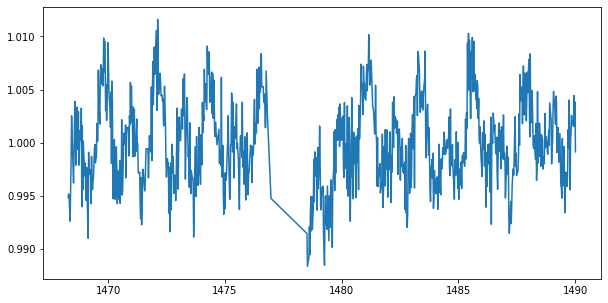

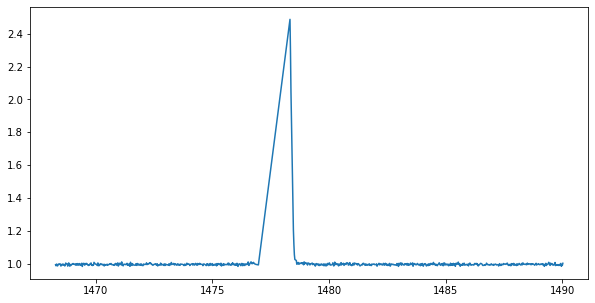

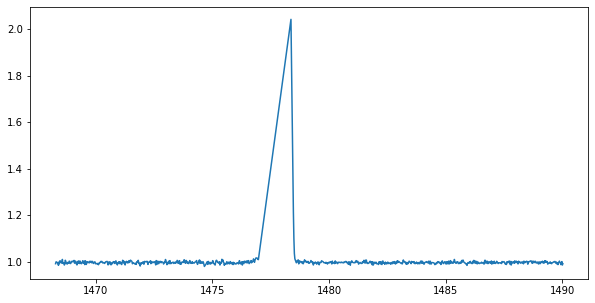

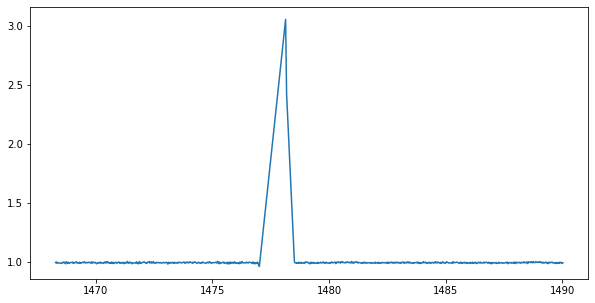

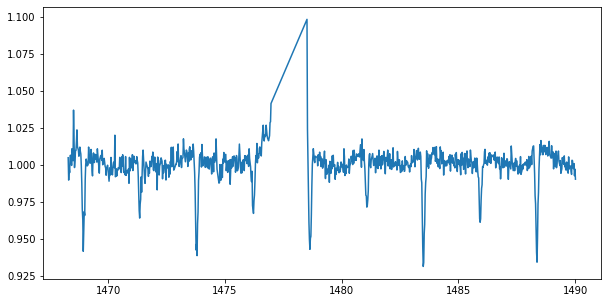

...

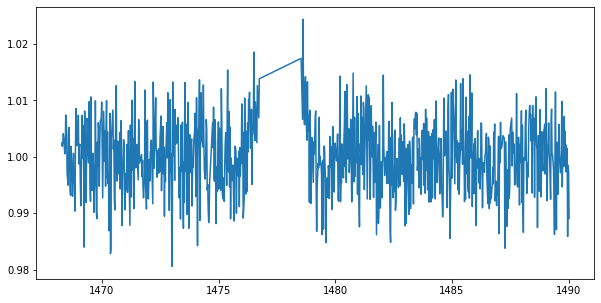

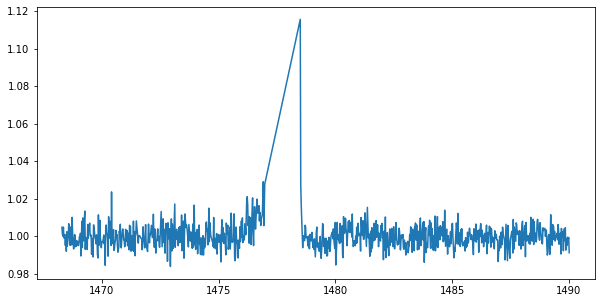

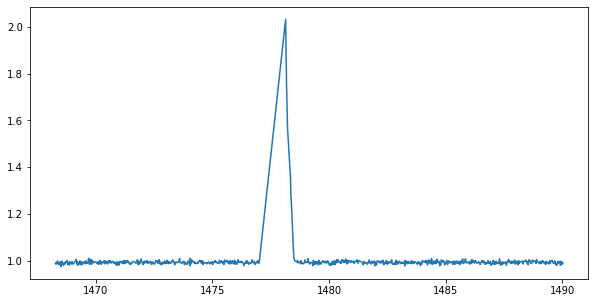

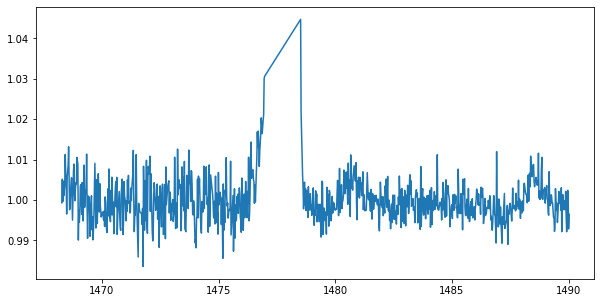

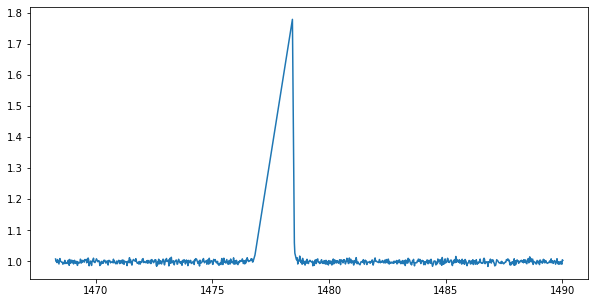

In [16]:
for i in list_tic_faulty[0:50]:
    star = eleanor.Source(tic=i, sector=6)
    data = eleanor.TargetData(star, height=15, width=15, bkg_size=31, do_psf=False, do_pca=True, regressors='corner')
    q = data.quality == 0
    fig2,ax2 = plt.subplots(1,figsize=(10,5))
    ax2.plot(data.time[q],normalise_lc(data.corr_flux[q]))

In [44]:
def eleanor_api_convert(tic):
    """Converting eleanor lightcurves to dataframes to work with our pipeline"""
    star = eleanor.Source(tic=tic, sector=6)
    data = eleanor.TargetData(star, height=15, width=15, bkg_size=31, do_psf=False, do_pca=True, regressors='corner')
    df = pd.DataFrame([data.time,data.corr_flux,data.quality]).T
    columns =['time','corrected flux','quality']
    df.columns = columns
    return df

### Testing new function

INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_bkg.fits with expected size 61162560. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc.fits with expected size 122411520. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-0804-0862_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4_tess_v2_pm.txt with expected size 184377. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-1294-1402_tess_v2_pc/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-1294-1402_tess_v2_bkg.fits with expected size 61162560. [astroquery.query]
INFO: Found cached file ./mastDownload/HLSP/hlsp_eleanor_tess_ffi_postcard-s0006-1-4-cal-1294-1402

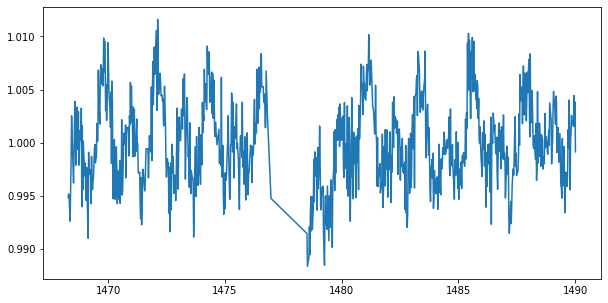

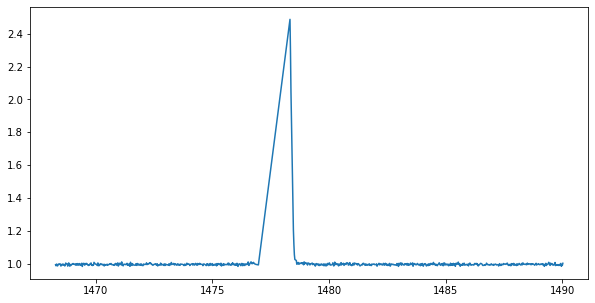

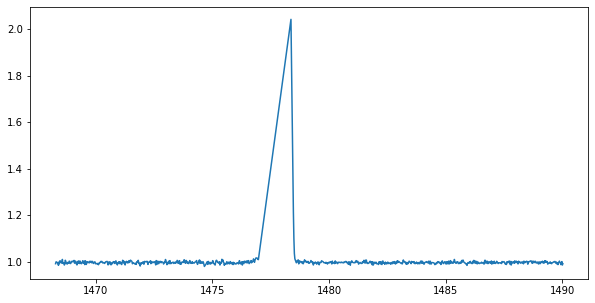

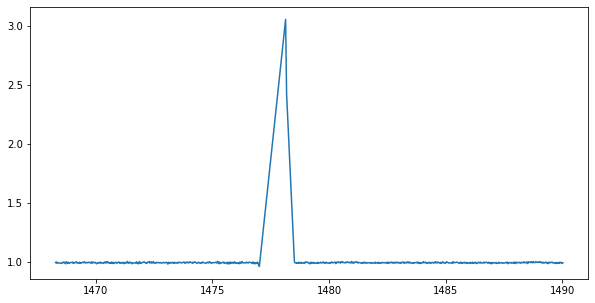

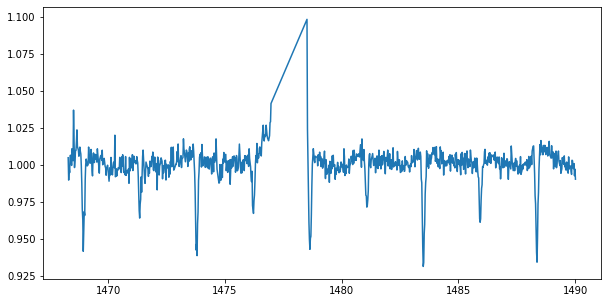

...

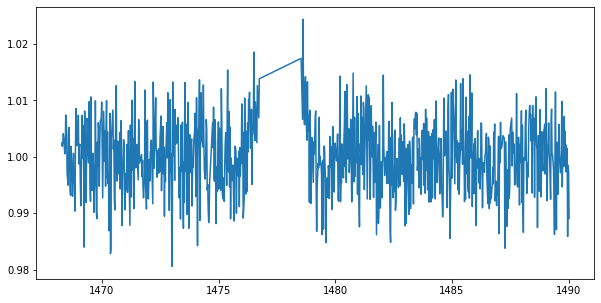

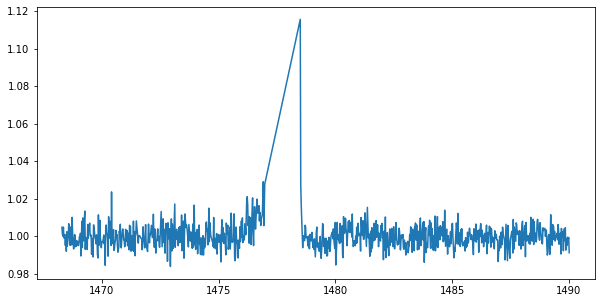

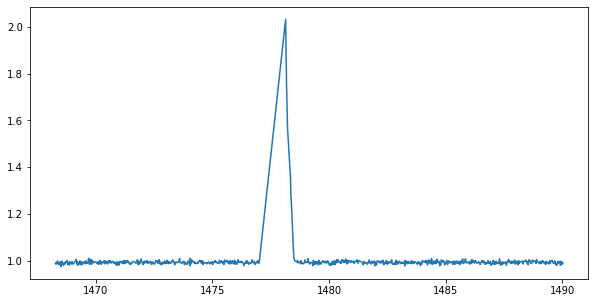

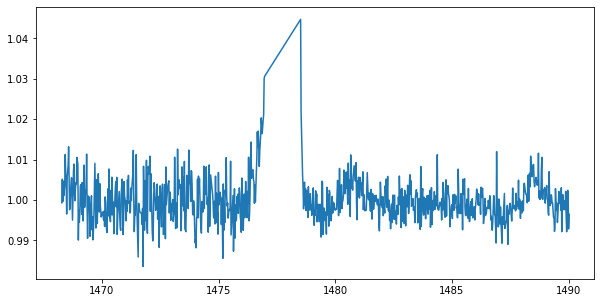

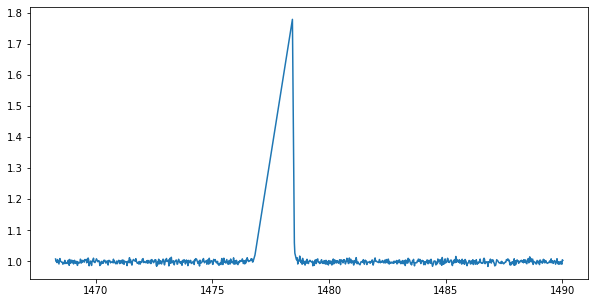

In [54]:
for i in list_tic_faulty[0:50]:
    df = eleanor_api_convert(i)
    q = df.quality == 0
    fig2,ax2 = plt.subplots(1,figsize=(10,5))
    ax2.plot(df.time[q],normalise_lc(df['corrected flux'][q]))